In [1]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import geopandas as gpd
import geoplot
import geoplot.crs as gcrs
import matplotlib.pyplot as plt
import math
import seaborn as sns
import plotly.express as px
import numpy as np
from tslearn.clustering import TimeSeriesKMeans
from plotly.subplots import make_subplots


import folium
from folium import plugins

In [2]:
def get_rolling_mean(df,location_col,location_param,col,num,center): 
    df_rolling = df.copy() 
    df_rolling = df_rolling.loc[df_rolling[location_col] == location_param].copy() 
    for cols in col: 
        df_rolling[f"Rolling_{cols}"] = df_rolling[cols].rolling(int(num),center=center).mean() 
    return df_rolling

# Importo dataset utili

In [3]:
# dataset con i dati di rilevamento
rilevazioni = pd.read_csv("FILES/merged_datas.csv")
# modifica del campo Data: da object a datetime
rilevazioni['Data'] = rilevazioni.Data.apply(pd.to_datetime)

# anagrafica stazioni
anagrafica_centraline = pd.read_csv("FILES/aq_labservice_anagrafica_stazioni.csv")

anagrafica_centraline = anagrafica_centraline[['denominazione', 'indirizzo','latitudine', 'longitudine']]
anagrafica_centraline['denominazione'] = anagrafica_centraline.denominazione.str.upper()
anagrafica_centraline.rename(columns = {'denominazione': 'Location'}, inplace = True)
anagrafica_centraline['Location'] = anagrafica_centraline.Location.str.replace(" ", "")
anagrafica_centraline.loc[anagrafica_centraline.Location.str.contains("COCOMARO"), "Location"] = "COCOMARO"

In [4]:
# colonne inquinanti
inquinanti = {
    "O3": "ozono",
    "Pr": "pressione",
    "RH": "umidità relativa",
    "T": "temperatura",
    "VOC": "volatile organic compounds"
}
for c in inquinanti.keys():
    title = c + ": " + inquinanti[c]
    fig = px.line(rilevazioni, x ="Data", y=c, color = "Location", title = title)
    
    
    fig.show()

# Analisi correlazioni tra inquinanti

<AxesSubplot:>

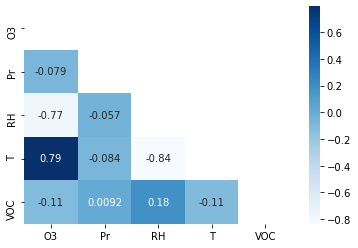

In [5]:
cmap=sns.diverging_palette(5, 250, as_cmap=True)

corr = rilevazioni[inquinanti.keys()].corr()

mask = np.zeros_like(corr)
trinangle_indeces = np.triu_indices_from(mask)
mask[trinangle_indeces] = True
sns.heatmap(corr, cmap="Blues", annot=True, mask = mask)

In [6]:
fig = px.scatter(data_frame=rilevazioni, x = "O3", y = "T", title="Correlation O3 - T", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='LightSkyBlue')), opacity = 0.1,
                  selector=dict(mode='markers'))

In [7]:
fig = px.scatter(data_frame=rilevazioni, x = "O3", y = "RH", title="Correlation O3 - RH", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='LightSkyBlue')), opacity = 0.1,
                  selector=dict(mode='markers'))

In [8]:
fig = px.scatter(data_frame=rilevazioni, x = "RH", y = "T", title="Correlation RH - T", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='LightSkyBlue')), opacity = 0.1,
                  selector=dict(mode='markers'))

In [41]:
rolling_df = pd.DataFrame()
for centralina in list(rilevazioni.Location.unique()):
    prova = get_rolling_mean(rilevazioni, "Location", centralina, ["O3", "Pr", "RH", "T", "VOC"],48,False)
    rolling_df = rolling_df.append(prova)
rolling_df = rolling_df.sort_values(by='Data', ascending = False)
for c in rolling_df:
    if 'Rolling' in c:
        title = c.split("_",1)[1]
        fig = px.line(rolling_df, x ="Data", y=c, color = "Location", title = title)
        fig.show()

# Densità alberi

In [10]:
alberi = pd.read_csv('FILES/alberi.csv')
alberi = alberi[['GID', 'LAT', 'LON']]
alberi.head()

,GID,LAT,LON
0,1,44.84549,11.62973
1,2,44.84554,11.62985
2,3,44.84928,11.62434
3,4,44.84926,11.62422
4,5,44.84927,11.62413


In [14]:
def  distanza_albero_stazione(stazioni, alberi):
    #lista stazioni
    stazioni_lst = stazioni['Location'].to_list()
    # calcolo distanza
    for st in stazioni_lst:
        nome_colonna_distanza_gradi = "Distanza_Gradi_" + str(st)
        nome_colonna_distanza_metri = "Distanza_Metri_" + str(st)
        alberi[nome_colonna_distanza_gradi] = (alberi['LAT'] - stazioni[stazioni.Location == st]['latitudine'].to_list()[0])**2 + (alberi['LON'] - stazioni[stazioni.Location == st]['longitudine'].to_list()[0])
        alberi[nome_colonna_distanza_gradi] = alberi[nome_colonna_distanza_gradi].apply(lambda x: math.sqrt(abs(x)) )
        alberi[nome_colonna_distanza_metri] = alberi[nome_colonna_distanza_gradi] * 111139
    
    return alberi


In [17]:
from numpy import sin, cos, arccos, pi, round

def rad2deg(radians):
    degrees = radians * 180 / pi
    return degrees

def deg2rad(degrees):
    radians = degrees * pi / 180
    return radians

def getDistanceBetweenPointsNew(latitude1, longitude1, latitude2, longitude2):
    theta = longitude1 - longitude2

    distance = 60 * 1.1515 * rad2deg(
        arccos(
            (sin(deg2rad(latitude1)) * sin(deg2rad(latitude2))) + 
            (cos(deg2rad(latitude1)) * cos(deg2rad(latitude2)) * cos(deg2rad(theta)))
        )
    )

    return round(distance * 1.609344,2)





In [23]:
df_distanza_alberi = pd.DataFrame()
latitudine = anagrafica_centraline[anagrafica_centraline.Location == 'BARCO']['latitudine'].to_list()[0]
longitudine = anagrafica_centraline[anagrafica_centraline.Location == 'BARCO']['longitudine'].to_list()[0]

for idx_centralina, centralina in enumerate(anagrafica_centraline.Location.to_list()):
    latitudine = anagrafica_centraline.latitudine[idx_centralina]
    longitudine = anagrafica_centraline.longitudine[idx_centralina]
    df = alberi.copy()

    for idx, albero_id in enumerate(alberi.GID.to_list()):
        lat_albero = alberi.LAT[idx]
        lon_albero = alberi.LON[idx]

        distance = getDistanceBetweenPointsNew(latitudine, longitudine, lat_albero, lon_albero)

        df.loc[df.GID == albero_id, 'Distance'] = distance
        df['CENTRALINA'] = centralina

    df_distanza_alberi = df_distanza_alberi.append(df)
df_distanza_alberi   
    

,GID,LAT,LON,Distance,CENTRALINA
0,1,44.84549,11.62973,2.44,BARCO
1,2,44.84554,11.62985,2.44,BARCO
2,3,44.84928,11.62434,1.84,BARCO
3,4,44.84926,11.62422,1.84,BARCO
4,5,44.84927,11.62413,1.83,BARCO
...,...,...,...,...,...
25547,25642,44.82956,11.61985,2.19,CORTIDIMEDORO
25548,25643,44.82972,11.61963,2.18,CORTIDIMEDORO
25549,25644,44.82962,11.61978,2.19,CORTIDIMEDORO
25550,25645,44.82968,11.61968,2.19,CORTIDIMEDORO


In [38]:
density1km = df_distanza_alberi[df_distanza_alberi.Distance <= 1.0].groupby('CENTRALINA').count()['GID'].to_frame().rename(columns = {'GID': 'Density_1km'}).reset_index()
density2km = df_distanza_alberi[df_distanza_alberi.Distance <= 2.0].groupby('CENTRALINA').count()['GID'].to_frame().rename(columns = {'GID': 'Density_2km'}).reset_index()
density3km = df_distanza_alberi[df_distanza_alberi.Distance <= 3.0].groupby('CENTRALINA').count()['GID'].to_frame().rename(columns = {'GID': 'Density_3km'}).reset_index()

In [40]:
density = pd.merge(density1km, density2km, on = ['CENTRALINA'])
density = pd.merge(density, density3km, on = ['CENTRALINA'])
density

,CENTRALINA,Density_1km,Density_2km,Density_3km
0,ARGINONE,9,2405,8880
1,BARCO,1258,4796,8825
2,BOLOGNA,257,1500,3374
3,COCOMARO,174,366,891
4,CORSOISONZO,4164,9586,16454
5,CORTIDIMEDORO,2109,3746,6844
6,CUSFERRARA,2026,8258,15392
7,DARSENA,3133,8643,15558
8,MODENA,1974,7500,11528
9,MOSTI,2679,7186,14897


In [48]:
mean_pollutants = rilevazioni.groupby('Location').mean()[['O3', 'Pr', 'RH', 'T']].reset_index().rename(columns = {'Location': 'CENTRALINA'})
density_analysis = pd.merge(mean_pollutants, density, on = 'CENTRALINA')

In [49]:
density_analysis

,CENTRALINA,O3,Pr,RH,T,Density_1km,Density_2km,Density_3km
0,ARGINONE,71.976170,1013.920167,48.224882,29.501632,9,2405,8880
1,BARCO,81.571180,1013.964936,49.588566,28.956080,1258,4796,8825
2,BOLOGNA,73.565686,1013.436855,47.957662,28.522513,257,1500,3374
3,COCOMARO,81.052736,1014.423994,49.143349,28.883545,174,366,891
4,CORSOISONZO,93.886751,1014.573249,47.921851,29.452849,4164,9586,16454
5,CUSFERRARA,96.402827,1014.095034,51.514099,28.507829,2026,8258,15392
6,MODENA,73.486497,1014.717060,44.354301,30.101851,1974,7500,11528
7,MOSTI,90.061494,1013.969978,43.566933,30.157179,2679,7186,14897
8,PONTELAGOSCURO,79.389148,1014.404734,47.185178,29.609723,113,550,1293
9,POROTTO,111.076806,1014.132450,43.621633,29.599093,457,858,1367


<AxesSubplot:>

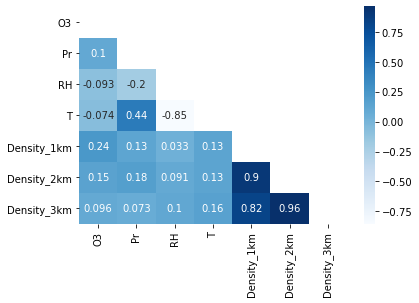

In [50]:
cmap=sns.diverging_palette(5, 250, as_cmap=True)

corr = density_analysis[density_analysis.keys()].corr()

mask = np.zeros_like(corr)
trinangle_indeces = np.triu_indices_from(mask)
mask[trinangle_indeces] = True
sns.heatmap(corr, cmap="Blues", annot=True, mask = mask)

# Analisi giorni

In [51]:
rilevazioni

,Data,Day_of_Week,Location,Month_Name,O3,Pr,RH,T,VOC
0,2022-05-31 22:00:00,Tuesday,ARGINONE,May,26.1,1013.9,75.0,22.5,82.4213
1,2022-05-31 23:00:00,Tuesday,ARGINONE,May,21.9,1013.8,78.0,21.6,82.6649
2,2022-06-01 00:00:00,Wednesday,ARGINONE,June,22.1,1013.7,80.6,21.2,83.0016
3,2022-06-01 01:00:00,Wednesday,ARGINONE,June,20.7,1013.9,82.0,21.2,82.7855
4,2022-06-01 02:00:00,Wednesday,ARGINONE,June,20.1,1014.1,82.9,21.2,82.8018
...,...,...,...,...,...,...,...,...,...
33057,2022-09-23 17:00:00,Friday,VILLAFULVIA,September,98.3,1017.5,44.4,20.4,201.0107
33058,2022-09-23 18:00:00,Friday,VILLAFULVIA,September,80.2,1017.7,49.9,18.6,203.2332
33059,2022-09-23 19:00:00,Friday,VILLAFULVIA,September,68.9,1017.9,53.3,17.7,204.8476
33060,2022-09-23 20:00:00,Friday,VILLAFULVIA,September,56.1,1017.7,56.3,17.1,206.6512


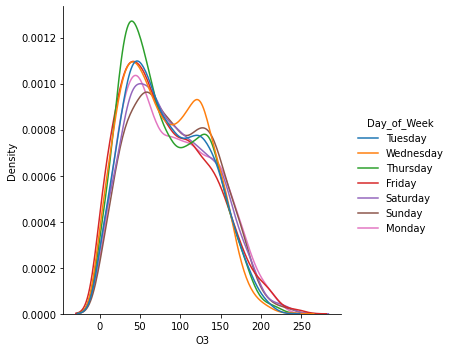

In [56]:
sns.displot(rilevazioni, x="O3", hue="Day_of_Week", kind="kde")


In [87]:
from shapely.wkt import loads
densita_pop = pd.read_csv('FILES/Distribuzione_popolazione_2021_OD_preview.csv')
densita_pop

def load_valid(geo):
    try:
        return loads(geo)
    except:
        return np.nan

densita_pop.the_geom = densita_pop.the_geom.apply(load_valid)
gdf = gpd.GeoDataFrame(densita_pop, geometry='the_geom')

In [92]:
densita_pop

,FID,the_geom,RECNO,N00_09,N10_70,NOVER70,NUMFAM,NCIV,NRES,R0_9N,R10_70N,NO70N,NRESN,AREA
0,Distribuzione_popolazione_2021_OD_preview.1,"MULTIPOLYGON (((1694760.001 4977362.085, 16948...",3873,<10,<10,<10,3,3,<10,1.0,6.0,NaN,7,16627.703
1,Distribuzione_popolazione_2021_OD_preview.2,"MULTIPOLYGON (((1694760.001 4978193.470, 16948...",3879,<10,<10,<10,6,2,10,NaN,9.0,1.0,10,16627.703
2,Distribuzione_popolazione_2021_OD_preview.3,"MULTIPOLYGON (((1694760.001 4978332.034, 16948...",3880,<10,<10,<10,4,4,<10,NaN,3.0,4.0,7,16627.703
3,Distribuzione_popolazione_2021_OD_preview.4,"MULTIPOLYGON (((1694760.001 4978470.598, 16948...",3881,<10,<10,<10,4,4,10,NaN,8.0,2.0,10,16627.703
4,Distribuzione_popolazione_2021_OD_preview.5,"MULTIPOLYGON (((1694880.001 4978124.188, 16949...",4123,<10,<10,<10,1,1,<10,NaN,NaN,1.0,1,16627.703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4372,Distribuzione_popolazione_2021_OD_preview.4373,"MULTIPOLYGON (((1726920.016 4962535.724, 17269...",69158,<10,<10,<10,2,2,<10,NaN,4.0,NaN,4,16627.703
4373,Distribuzione_popolazione_2021_OD_preview.4374,"MULTIPOLYGON (((1726920.016 4962674.288, 17269...",69159,<10,<10,<10,3,3,<10,3.0,4.0,2.0,9,16627.703
4374,Distribuzione_popolazione_2021_OD_preview.4375,"MULTIPOLYGON (((1726920.016 4964614.186, 17269...",69173,<10,<10,<10,1,1,<10,NaN,1.0,1.0,2,16627.703
4375,Distribuzione_popolazione_2021_OD_preview.4376,"MULTIPOLYGON (((1727040.016 4962882.134, 17270...",69405,<10,<10,<10,2,2,<10,NaN,2.0,1.0,3,16627.703


In [104]:
m = folium.Map(location=[44.83976409335375, 11.60610201062589], tiles="Stamen Terrain",zoom_start = 13)
for idx, c in enumerate(anagrafica_centraline.Location.to_list()):
    descrizione = c
    lat = anagrafica_centraline.latitudine[idx]
    lon = anagrafica_centraline.longitudine[idx]
    folium.Marker(
        location=[lat, lon],
        popup="Centralina: " + c,
        icon=folium.Icon(icon="cloud", prefix='fa'),
    ).add_to(m)

for _, r in gdf.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['the_geom']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j)
    geo_j.add_to(m)



m.save("Map_Centraline.html")
m

In [108]:
geo_j

In [109]:
rilevazioni.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33062 entries, 0 to 33061
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data         33062 non-null  datetime64[ns]
 1   Day_of_Week  33062 non-null  object        
 2   Location     33062 non-null  object        
 3   Month_Name   33062 non-null  object        
 4   O3           33062 non-null  float64       
 5   Pr           33062 non-null  float64       
 6   RH           33062 non-null  float64       
 7   T            33062 non-null  float64       
 8   VOC          33062 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(3)
memory usage: 2.3+ MB


In [111]:
rilevazioni.replace(0, np.nan, inplace=True)

In [121]:
rilevazioni

,Data,Day_of_Week,Location,Month_Name,O3,Pr,RH,T,VOC
0,2022-05-31 22:00:00,Tuesday,ARGINONE,May,26.1,1013.9,75.0,22.5,82.4213
1,2022-05-31 23:00:00,Tuesday,ARGINONE,May,21.9,1013.8,78.0,21.6,82.6649
2,2022-06-01 00:00:00,Wednesday,ARGINONE,June,22.1,1013.7,80.6,21.2,83.0016
3,2022-06-01 01:00:00,Wednesday,ARGINONE,June,20.7,1013.9,82.0,21.2,82.7855
4,2022-06-01 02:00:00,Wednesday,ARGINONE,June,20.1,1014.1,82.9,21.2,82.8018
...,...,...,...,...,...,...,...,...,...
33057,2022-09-23 17:00:00,Friday,VILLAFULVIA,September,98.3,1017.5,44.4,20.4,201.0107
33058,2022-09-23 18:00:00,Friday,VILLAFULVIA,September,80.2,1017.7,49.9,18.6,203.2332
33059,2022-09-23 19:00:00,Friday,VILLAFULVIA,September,68.9,1017.9,53.3,17.7,204.8476
33060,2022-09-23 20:00:00,Friday,VILLAFULVIA,September,56.1,1017.7,56.3,17.1,206.6512
